In [1]:
from simulator import Simulator, generateDisk3Dv3
import torch
from generation import generate_scene_multidisk
from visualization import animate_scene


def gen_params(device="cpu"):
    return {
        'nbStars': 250,
        'radius': 1,
        'Mass': 1,
        'zOffsetMax': torch.rand(1, device=device).item() * 0.5,
        'gravityCst': 1.0,
        'offset': (torch.rand(3, device=device) * 2 - 1).tolist(),
        'initial_vel': (torch.rand(3, device=device) * 0.2 - 0.1).tolist(),
        'clockwise': int(torch.randint(0, 2, (1,), device=device).item()),
        'angle': ((torch.rand(3, device=device) * 2 - 1) * 2 * torch.pi).tolist()
    }

pos, vel, mass = generateDisk3Dv3(**gen_params(device="cuda"))


sim = Simulator(
    positions=pos,
    velocities=vel,
    masses=mass,
    G=1.0,
    dt=0.01,
    softening=0.1,
    device="cuda")

In [2]:
# plot animation in 3d

result = sim.run(1000)

In [2]:
scene, masses = generate_scene_multidisk(2, frames=2500, device='cuda')

In [15]:
scene[0]

{'positions': tensor([[-0.5518, -0.8211, -0.0640],
         [-0.4570, -0.8086, -0.8753],
         [-0.2813, -0.6301, -0.4874],
         ...,
         [ 0.5091, -1.2410, -1.1200],
         [ 0.5090, -0.9809, -0.6252],
         [-0.0656,  0.2952, -1.2189]], device='cuda:0'),
 'velocities': tensor([[ 0.0733,  0.0059, -0.0650],
         [-0.7534, -0.7096, -0.1675],
         [-0.7105, -0.7121, -0.9079],
         ...,
         [-0.2835,  0.3209, -0.8492],
         [-0.1155, -0.2609, -1.0812],
         [-0.0878,  0.6335,  0.9740]], device='cuda:0'),
 'accelerations': tensor([[ 0.5016,  0.2986, -0.4413],
         [ 0.9595,  0.7203,  1.6328],
         [ 0.1221, -0.2127,  1.6543],
         ...,
         [-0.5424,  0.9981,  0.6315],
         [-1.3354,  1.8761, -0.0809],
         [ 0.4013, -1.2755,  0.9787]], device='cuda:0')}

In [3]:
positions = torch.stack([r['positions'] for r in scene], dim=0)
positions.shape, masses.shape

(torch.Size([2500, 502, 3]), torch.Size([502]))

In [7]:
positions.device

device(type='cuda', index=0)

In [8]:
masses.device

device(type='cuda', index=0)

In [11]:
print(masses)

tensor([9.9998e-01, 2.4348e-08, 6.1084e-08, 3.2569e-08, 2.5048e-08, 2.8191e-08,
        1.9440e-08, 2.8656e-08, 2.6326e-08, 2.4432e-08, 6.1976e-07, 6.1628e-08,
        2.0135e-07, 2.7570e-08, 2.3478e-08, 2.7383e-08, 2.7570e-08, 3.8622e-08,
        2.1866e-08, 1.7151e-08, 5.0029e-08, 1.2793e-07, 1.5455e-08, 7.7080e-08,
        1.5603e-08, 2.8720e-08, 4.4497e-08, 1.9421e-08, 5.2180e-08, 2.1498e-08,
        4.2740e-08, 1.8054e-08, 1.9470e-08, 2.7818e-08, 1.9180e-08, 5.6655e-08,
        4.6512e-08, 3.2855e-08, 2.0000e-08, 1.5398e-08, 1.9445e-08, 4.3910e-08,
        1.9961e-08, 9.2661e-08, 3.5406e-07, 9.4082e-08, 2.9233e-08, 3.4044e-08,
        2.1826e-08, 3.4073e-07, 6.7041e-08, 1.8708e-08, 2.1646e-08, 5.5343e-08,
        3.8226e-08, 2.1768e-08, 1.5371e-08, 2.9343e-08, 1.7200e-08, 2.4531e-08,
        1.5632e-08, 2.1432e-08, 9.3102e-08, 1.8492e-08, 2.7839e-08, 1.3514e-07,
        2.3124e-07, 2.1183e-08, 9.1548e-08, 6.2655e-08, 3.4419e-08, 4.5603e-08,
        3.3513e-07, 3.2015e-08, 8.3208e-

In [12]:
print(positions[0])

tensor([[-0.5518, -0.8211, -0.0640],
        [-0.4570, -0.8086, -0.8753],
        [-0.2813, -0.6301, -0.4874],
        ...,
        [ 0.5091, -1.2410, -1.1200],
        [ 0.5090, -0.9809, -0.6252],
        [-0.0656,  0.2952, -1.2189]], device='cuda:0')


In [10]:
feats = torch.cat((positions, masses.unsqueeze(0).repeat(positions.size(0), 1).unsqueeze(-1)), dim=-1)

print(feats.shape)

torch.Size([2500, 502, 4])


In [13]:
print(feats[0])

tensor([[-5.5175e-01, -8.2110e-01, -6.3975e-02,  9.9998e-01],
        [-4.5702e-01, -8.0857e-01, -8.7526e-01,  2.4348e-08],
        [-2.8133e-01, -6.3010e-01, -4.8743e-01,  6.1084e-08],
        ...,
        [ 5.0913e-01, -1.2410e+00, -1.1200e+00,  1.4986e-08],
        [ 5.0901e-01, -9.8087e-01, -6.2522e-01,  3.4573e-08],
        [-6.5598e-02,  2.9519e-01, -1.2189e+00,  2.2435e-08]], device='cuda:0')


In [14]:
torch.cat((feats, feats), dim=0).shape

torch.Size([5000, 502, 4])

In [13]:
mass.shape

torch.Size([251])

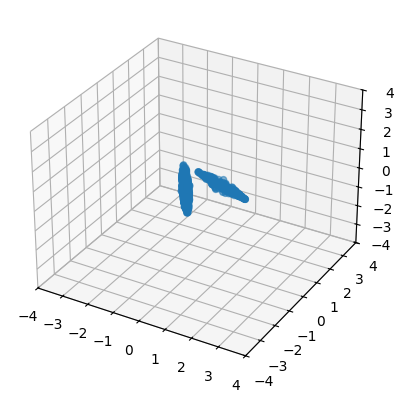

In [5]:
ani = animate_scene(positions=positions)

In [6]:
from IPython.display import HTML

In [7]:
HTML(ani.to_jshtml())

Animation size has reached 20995280 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [3]:
pos = result[0]['positions']
pos

tensor([[-7.3611e-01, -5.6225e-01, -1.9840e-02],
        [-8.3674e-01, -5.0206e-01, -8.0368e-01],
        [-1.4353e-01, -8.0971e-01,  1.0037e-01],
        [-1.1564e+00, -4.0019e-01,  3.2456e-01],
        [-1.2661e+00, -3.1407e-01,  6.9568e-01],
        [ 3.8491e-02, -9.1168e-01,  2.9443e-01],
        [-8.0246e-01, -5.2737e-01, -9.8098e-01],
        [-2.5121e-02, -8.9236e-01,  4.0609e-01],
        [-1.3541e+00, -2.7550e-01, -2.4440e-01],
        [-9.5449e-01, -3.8664e-01,  5.3898e-01],
        [-1.3568e+00, -2.8710e-01,  4.7555e-01],
        [ 1.0325e-01, -9.5070e-01, -3.1516e-01],
        [-1.1511e+00, -5.1518e-01, -1.8105e-01],
        [-1.0718e+00, -4.0244e-01, -7.9825e-01],
        [-1.5416e+00, -2.2424e-01,  6.9224e-02],
        [-3.3192e-01, -7.0371e-01, -1.5486e-01],
        [-2.7819e-01, -8.8641e-01, -2.6257e-01],
        [-1.2054e+00, -3.1358e-01, -6.8460e-01],
        [-1.1196e+00, -3.5999e-01, -4.3489e-01],
        [-6.0463e-01, -6.6039e-01,  7.5863e-01],
        [-9.3313e-01

In [36]:
positions = torch.stack([r['positions'] for r in result], dim=0)

In [37]:
positions.shape

torch.Size([1000, 251, 3])

In [47]:
torch.cat((positions, positions), dim=0).shape

torch.Size([2000, 251, 3])

In [40]:
def create_position_features(positions, k):
    """
    Create a feature array where each position at a given frame includes
    its k previous positions concatenated.
    
    Args:
        positions (torch.Tensor): Input tensor of shape (F, N, 3).
        k (int): Number of previous positions to concatenate.
    
    Returns:
        torch.Tensor: Feature tensor of shape (F, N, 3k).
    """
    F, N, _ = positions.shape
    feature_list = []
    
    for i in range(k):
        shifted_positions = torch.roll(positions, shifts=i+1, dims=0)
        shifted_positions[:i+1] = 0  # Set the first `i+1` frames to 0 (no previous data available)
        feature_list.append(shifted_positions)
    
    features = torch.cat(feature_list, dim=-1)  # Concatenate along the last dimension
    return features

k = 2
features = create_position_features(positions, k)

In [42]:
features.shape

torch.Size([1000, 251, 6])

In [46]:
print(positions[10, 0])
print(positions[9, 0], 'pos -1')
print(positions[8, 0], 'pos -2')
print(features[10, 0])

tensor([-0.7336, -0.5666, -0.0133], device='cuda:0')
tensor([-0.7339, -0.5661, -0.0139], device='cuda:0') pos -1
tensor([-0.7341, -0.5657, -0.0146], device='cuda:0') pos -2
tensor([-0.7339, -0.5661, -0.0139, -0.7341, -0.5657, -0.0146], device='cuda:0')


In [4]:
from torch_geometric.nn import radius_graph

In [16]:
# generate a radius graph, all edges should be bidirectional
edge_index = radius_graph(pos, r=0.2, batch=None, loop=False)

edge_index

tensor([[ 44,  61, 182,  ...,  79,  85, 154],
        [  0,   0,   0,  ..., 250, 250, 250]], device='cuda:0')

In [23]:
edge_index.shape

torch.Size([2, 1708])

In [26]:
# look for repeated edges
unique_edges = torch.unique(t, dim=0)
unique_edges.shape

torch.Size([1708, 2])